## Spades run analysis
`cat 160523Alm_D16-4703_2_sequence.fastq | head -5000000 | gzip > test_reads_2.fastq.gz`  
`cat 160523Alm_D16-4703_1_sequence.fastq | head -5000000 | gzip > test_reads_1.fastq.gz`  
`spades -1 test_reads_2.fastq.gz -2 test_reads_1.fastq.gz --meta -o spades_final_proj_output`

## Assembly-stats
- Using the assembly-stats program, calculate statistics on both your contigs and scaffolds file
- Report the total length of all contigs (or scaffolds), the number of contigs (or scaffolds), and the N50 

Code Line: output a tabular analysis with headers
`scp -r /Users/changhua/downloads/SPAdes-3.13.0-Darwin/bin/spades_final_proj_output be131-01@bioe131.com:fa18-BioE131/
`  
`assembly-stats -t ./scaffolds.fasta ./contigs.fasta > ./assembly_stats_report.txt`

`scp be131-01@bioe131.com:fa18-BioE131/spades_final_proj_output/assembly_stats_report.txt /Users/changhua/desktop/fa18-BioE131/final/checkpoint1/`

In [1]:
import pandas as pd
data = pd.read_csv('assembly_stats_report.txt',sep = "	")
data

,filename,total_length,number,mean_length,longest,shortest,N_count,Gaps,N50,N50n,N70,N70n,N90,N90n
0,./scaffolds.fasta,93996807,369721,254.24,5532,55,6690,660,263,122599,236,198063,206,282956
1,./contigs.fasta,93990117,370381,253.77,4581,55,0,0,263,123238,236,198719,206,283617


- Extract the coverage from each FASTA header
code: apply grep and awk, use ">" to separate each fasta, "_" to separate names, and print the name, length and coverage field
`grep '^>'  contigs.fasta | awk -F _  'BEGIN {OFS="\t"} {print $0,$4,$6}'> contig_cov.csv`
- plot a histogram of coverage for all contigs in your assembly

                               name  length  Coverage
1  >NODE_2_length_4289_cov_5.656117    4289  5.656117
2  >NODE_3_length_3988_cov_3.358505    3988  3.358505
3  >NODE_4_length_3973_cov_2.678663    3973  2.678663
4  >NODE_5_length_3735_cov_2.843478    3735  2.843478


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x10fd1bb38>]],
      dtype=object)

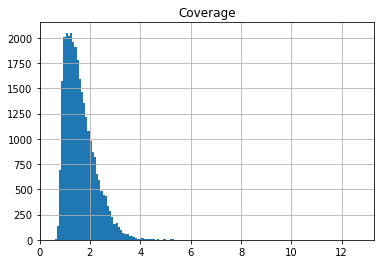

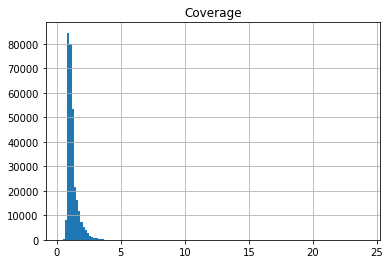

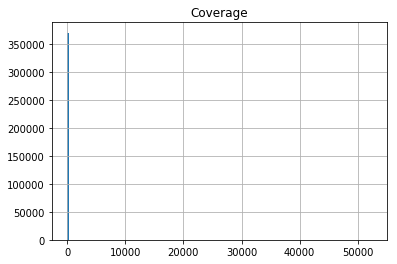

In [3]:
import pandas as pd
data = pd.read_csv('contig_cov.csv',sep = "	", header = None,names = ["name", "length","Coverage"])
# A demonstration of the first five lines
print(data[1:5])

# removing the single extremely high anomaly (multiple G and multiple T)for a closer look
cov1 = data[0:30000][["Coverage"]]
cov1.hist(bins=140)

cov2 = data[0:300000][["Coverage"]]
cov2.hist(bins=140)

cov3 = data[0:370000][["Coverage"]]
cov3.hist(bins=140)

## MG-RAST Annotation
- MG-RAST completed with seemingly reasonable output

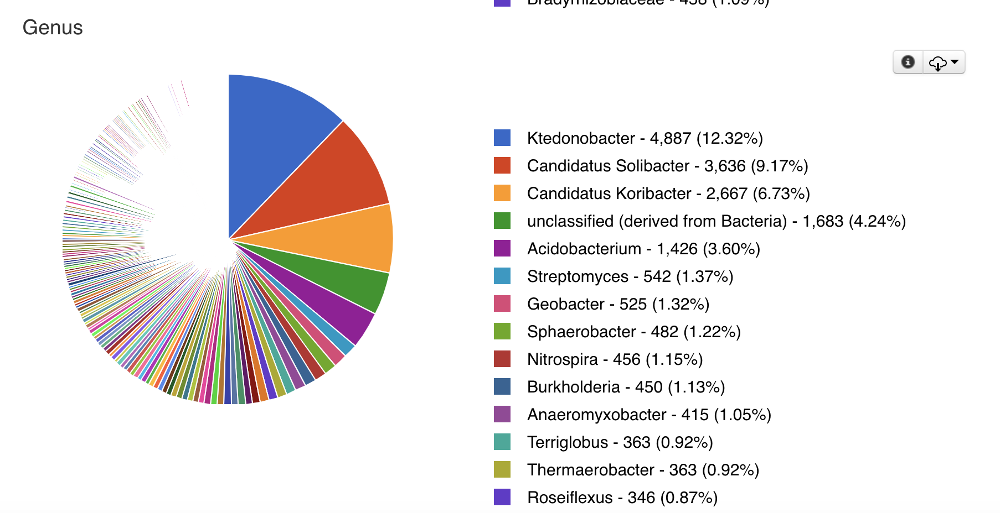

In [4]:
from IPython.display import Image, display
img1 = Image(filename = "img/1.PNG")
img1

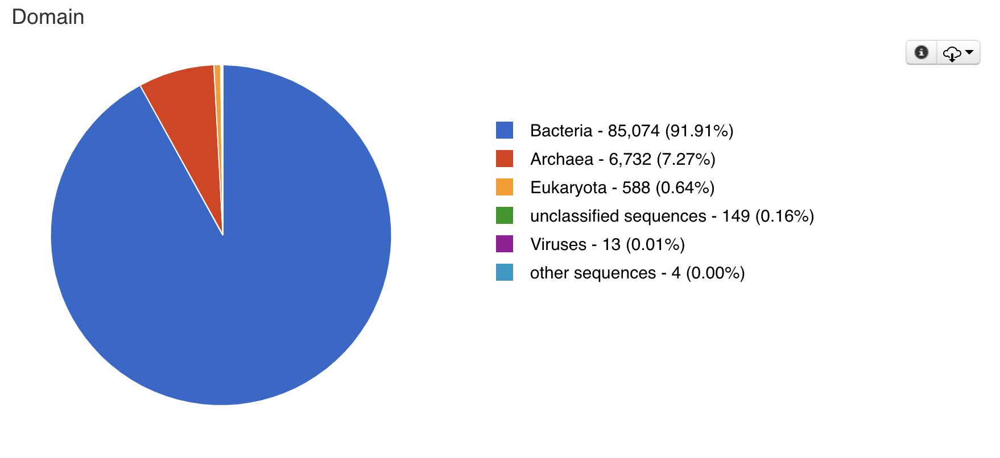

In [5]:
from IPython.display import Image, display
img2 = Image(filename = "img/2.PNG")
img2

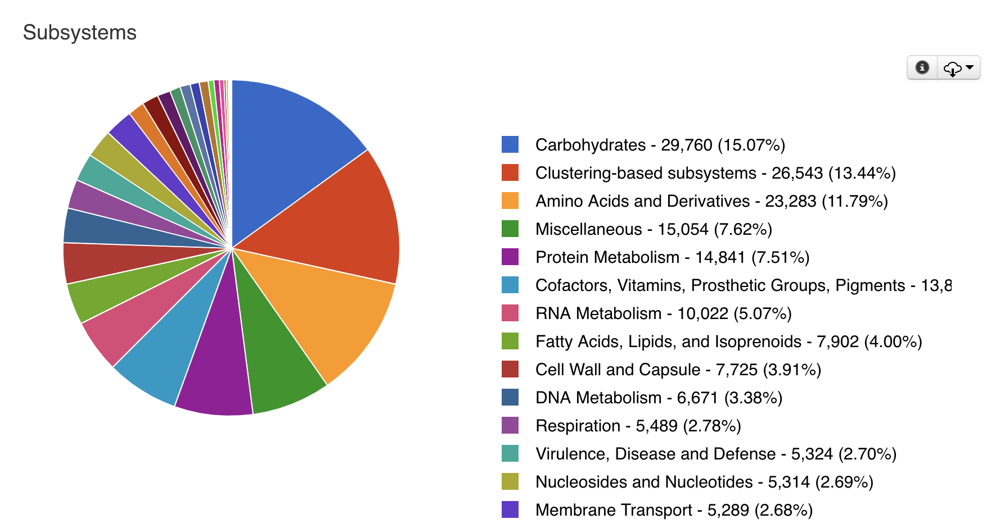

In [6]:
from IPython.display import Image, display
img3 = Image(filename = "img/3.PNG")
img3

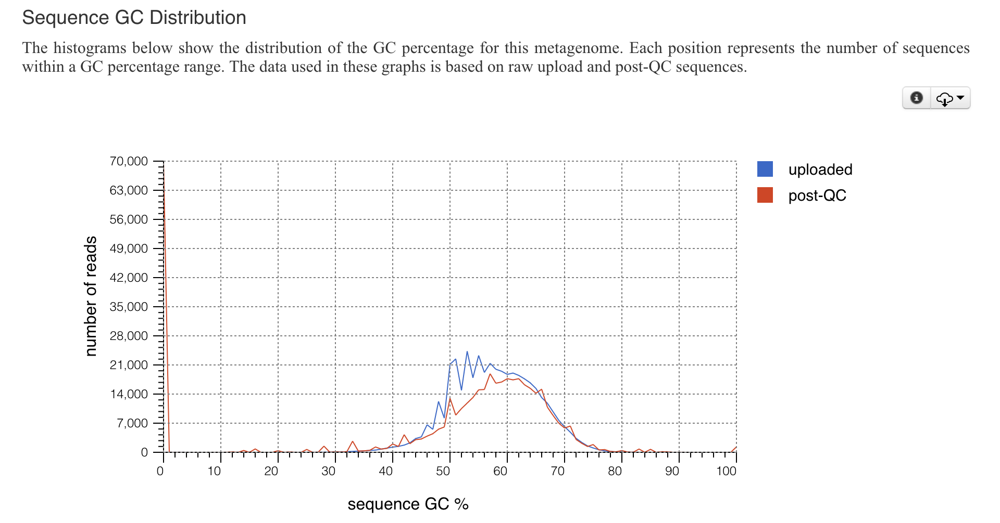

In [7]:
from IPython.display import Image, display
img4 = Image(filename = "img/4.PNG")
img4

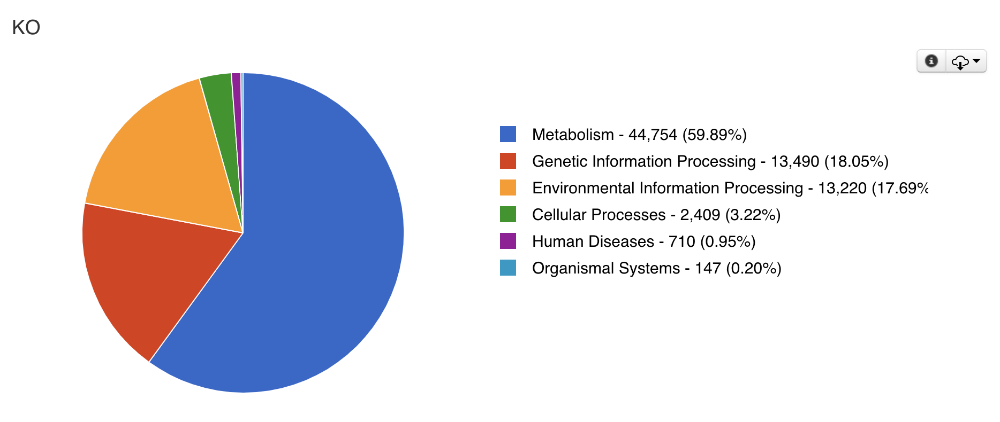

In [9]:
from IPython.display import Image, display
img5 = Image(filename = "img/5.PNG")
img5

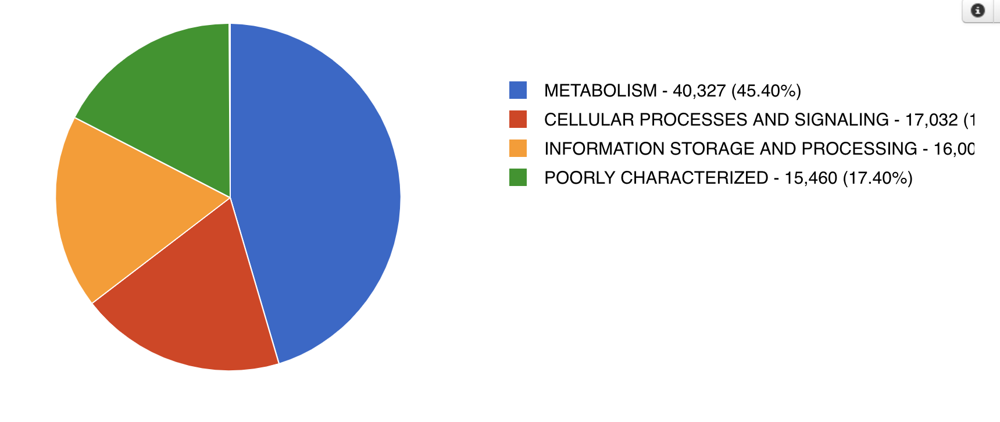

In [10]:
from IPython.display import Image, display
img6 = Image(filename = "img/6.PNG")
img6

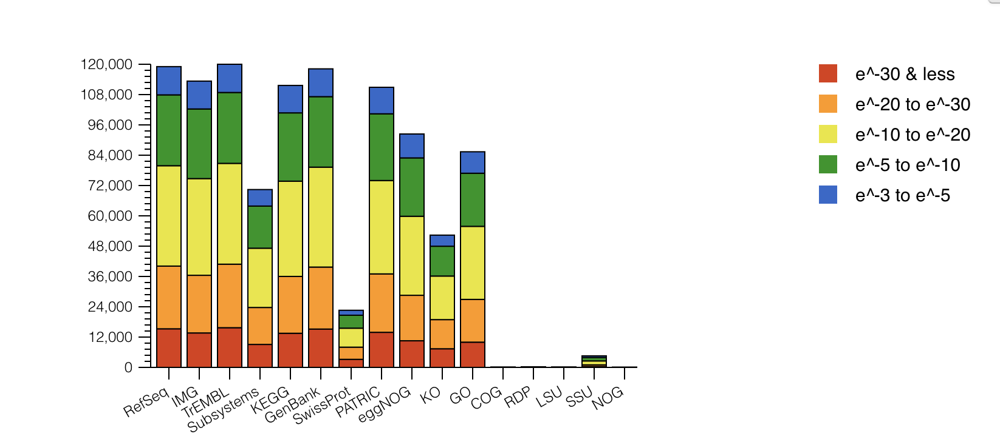

In [12]:
from IPython.display import Image, display
img7 = Image(filename = "img/7.PNG")
img7

## Project Proposal
### Purpose: 
Investigation on the distribution and physiological shifts of acidobacteria under radioactive response
### Procedure
1. General Abundance from one codex, select the most abundant strain for later analysis
2. Pathway analysis and clustering from MG-RAST/ compare with a normal soil meta-genome for differential pathway analysis compared to a normal reference genome
3. Extract the acidobacteria strain's genome from each layer, with same standard strains under normal condition construct a pseudo-time phylogenetic tree as a clock of mutation to infer the mutation rate under the radioactive soil environment
4. Meanwhile, reassemble data using 50% of the original size according to Stephen's suggestion   

### Challenges
1. For now only 10% of the genome is available from the assembly, and so the signal to noise ratio as well as the assembly efficiency may all not be ideal, leading to inaccurate data output from annotation
2. There's not a single standard for the selection of standard strain of acidobacteria, and so the final result may be different due to the subjective selection
3. It is questionable whether we should treat a cluster of data from annotation as a pseudo-organism to increase the available genome size or we should use the annotation from one single species.

### Current Focus 
- pull data from MG-RAST, and inspect the data
- try to extract all the genome annotation from acidobacteria

## MG-RAST Result Files:
- files are too big to be push to git, they are in the ./fa18-BioE131-final/ directory on the server  
E.G : `curl http://api.metagenomics.anl.gov/1/annotation/sequence/mgm4821375.3?auth=stdBBZyudaQcGk6WQRn374Ezx&evalue=10&type=ontology&source=Subsystems | tee ontology_Subsystems.txt
`

## 1. feature_greengenes
feature annotation from GreenGenes database

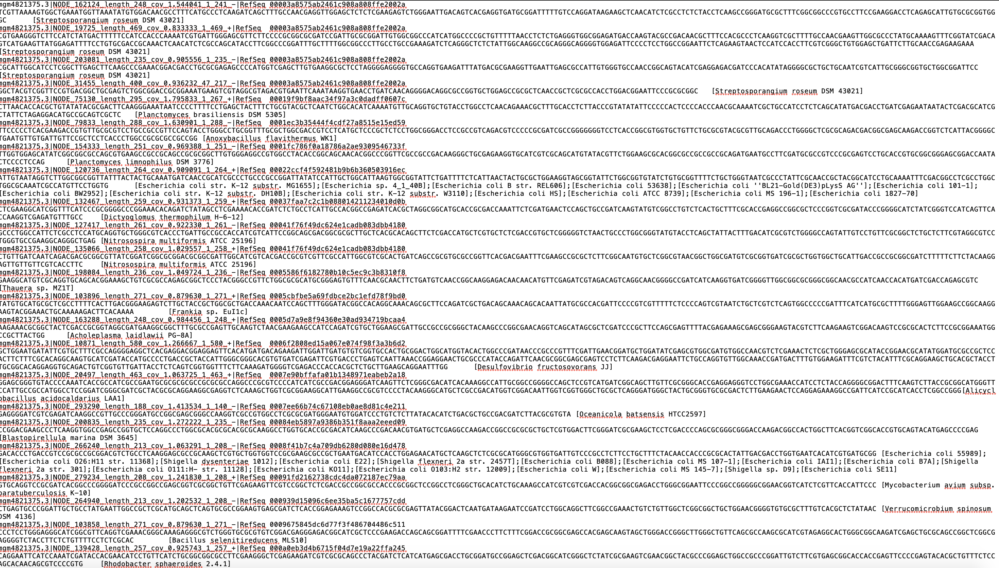

In [13]:
from IPython.display import Image, display
img8 = Image(filename = "img/feature_greengenes.PNG")
img8

## 2. ontology_COG
ontology annotation from COG

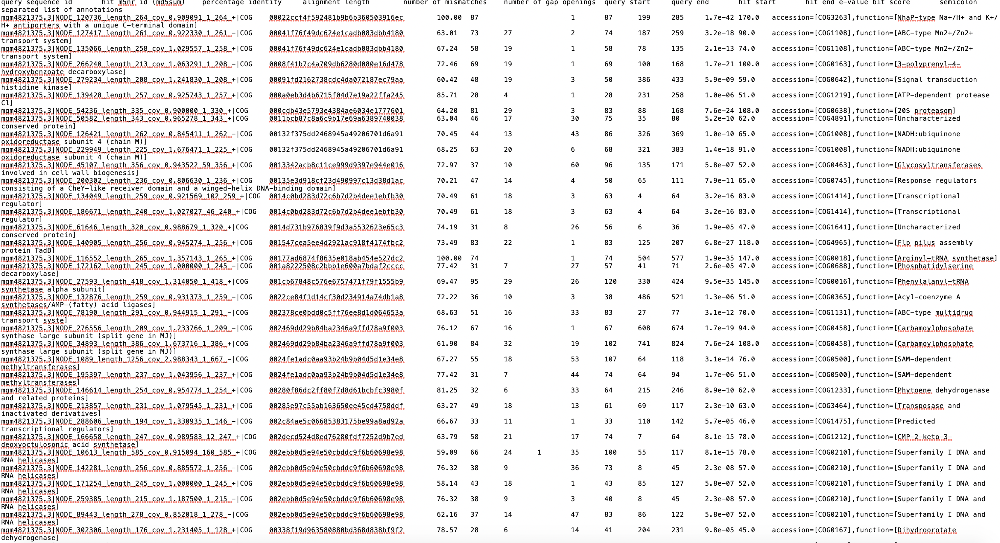

In [15]:
from IPython.display import Image, display
img9 = Image(filename = "img/ontology_COG.PNG")
img9

## 3. ontology_subsystems
ontology annotation from subsystems

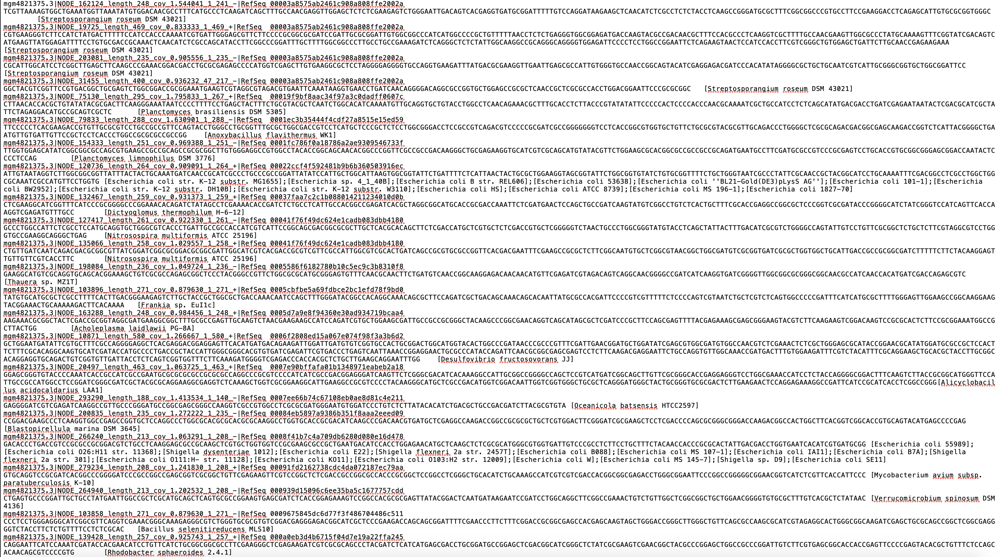

In [16]:
from IPython.display import Image, display
img10 = Image(filename = "img/ontology_subsystems.PNG")
img10

## 4. organism_genebank
organism annotation from genebank

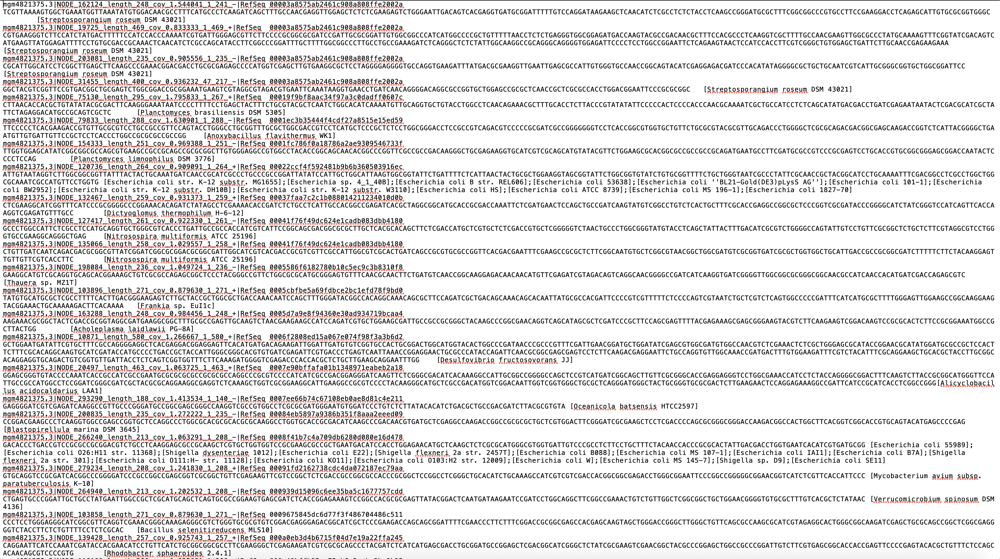

In [17]:
from IPython.display import Image, display
img11 = Image(filename = "img/organism_genebank.PNG")
img11

## 5. organism_refseq
organism annotation from RefSeq

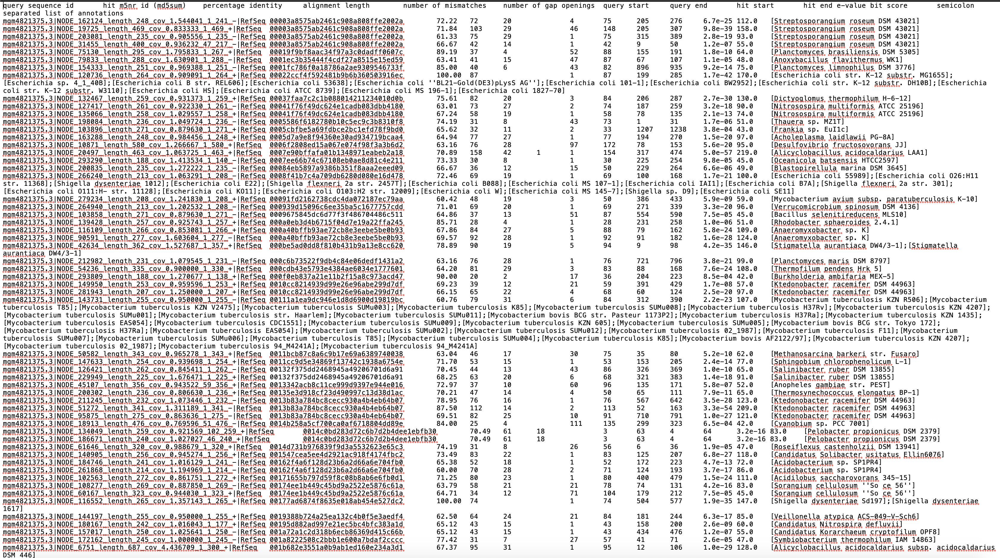

In [18]:
from IPython.display import Image, display
img12 = Image(filename = "img/organism_refseq.PNG")
img12

## To-Do:
1. Get the standard strain genome of the following acidobacteria:
    - [Acidobacterium sp. SP1PR4]
    - [Acidobacterium capsulatum ATCC 51196]
    - [Acidobacterium sp. MP5ACTX9]
    - [Acidobacterium sp. MP5ACTX8]
2. BLAST for differential expression of metabolic pathway
3. reconstruction of phylogenetic trace back